In [1]:
%load_ext autoreload
%autoreload 2

In [69]:
from L96 import *
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')

In [4]:
l96_one = L96OneLevel()

In [5]:
l96_one.iterate(10)

In [64]:
l96_two = L96TwoLevel(save_dt=0.001)

In [65]:
l96_two.iterate(10)

In [66]:
h = l96_two.history

In [56]:
h

<xarray.Dataset>
Dimensions:   (time: 101, x: 36, y: 360)
Coordinates:
  * time      (time) float64 0.0 0.1 0.2 0.3 0.4 0.5 ... 9.6 9.7 9.8 9.9 10.0
  * x         (x) int64 0 1 2 3 4 5 6 7 8 9 10 ... 26 27 28 29 30 31 32 33 34 35
  * y         (y) int64 0 1 2 3 4 5 6 7 8 ... 352 353 354 355 356 357 358 359
Data variables:
    X         (time, x) float64 0.1446 0.01142 0.135 ... -3.828 2.325 7.492
    B         (time, x) float64 -0.0 -0.0 -0.0 -0.0 ... 0.865 -0.9321 -2.817
    Y_mean    (time, x) float64 0.0 0.0 0.0 0.0 ... -0.08625 0.09405 0.2823
    Y2_mean   (time, x) float64 0.0 0.0 0.0 0.0 ... 0.0312 0.03938 0.1685
    X_repeat  (time, y) float64 0.1446 0.1446 0.1446 ... 7.492 7.492 7.492
    Y         (time, y) float64 0.0 0.0 0.0 0.0 ... 0.5441 0.106 -0.05042 0.6723

In [57]:
x_theta = [2*np.pi /36 * i for i in range(37)]
y_theta = [2*np.pi /360 * i for i in range(361)]

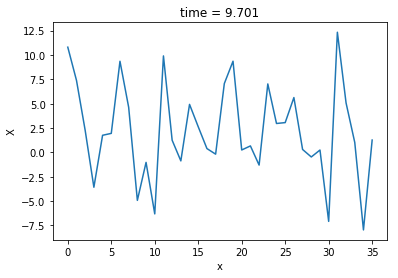

In [22]:
h.X[-300].plot()

In [58]:
def add_point(x):
    return np.append(x.values, x[0])

In [31]:
add_point(h.X[-1])

array([-7.51407608,  9.20887673,  1.17642644,  0.43326218,  3.30373545,
       -1.37071352,  9.03985383,  5.337093  ,  2.65593528,  3.61733753,
        6.64689777, 10.88531527,  2.1583884 , -1.4915829 ,  3.66708944,
        6.544156  ,  0.97113258,  0.99022535, -6.68337206,  2.52055299,
        8.32951732,  3.62160335,  0.59122916,  2.47798428,  0.76115552,
        8.50671626,  6.87867223,  0.15940254,  6.87331505,  8.5211606 ,
        4.60222636,  9.35955683,  4.33787051,  1.08908098, -0.27105096,
       -0.96770404, -7.51407608])

(<a list of 0 Line2D ticklines objects>,
 <a list of 0 Text major ticklabel objects>)

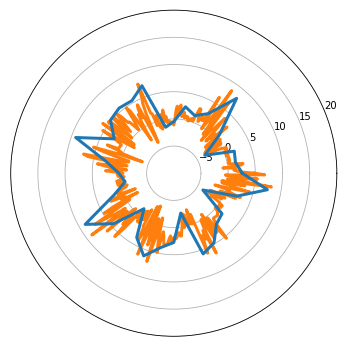

In [61]:
fig = plt.figure(figsize=(6,6))
ax = fig.add_subplot(111, projection='polar')
ax.plot(x_theta, add_point(h.X[-1]), lw=3, zorder=10)
ax.plot(y_theta, add_point(h.Y[-1])*10, lw=3)
ax.set_rmin(-10); ax.set_rmax(20)
ax.set_rticks([-5, 0, 5, 10, 15, 20])
ax.set_thetagrids([])

In [44]:
h.X.max(), h.X.min()

(<xarray.DataArray 'X' ()>
 array(17.149054), <xarray.DataArray 'X' ()>
 array(-10.112075))

In [78]:
import matplotlib.animation as animation
from IPython.display import HTML
fig = plt.figure(figsize=(6,6))
ax = fig.add_subplot(111, projection='polar')

line, = ax.plot([], [], lw=3, zorder=10)
line2, = ax.plot([], [], lw=2)
ax.set_rmin(-10); ax.set_rmax(20)
ax.set_rticks([-5, 0, 5, 10, 15, 20])
ax.set_thetagrids([])

def init():
    line.set_data([], [])
    return line,

def animate(i):
    x = add_point(h.X[i*3+5000])
    y = add_point(h.Y[i*3+5000])*10
    line.set_data(x_theta, x)
    line2.set_data(y_theta, y)
    return line, line2

ani = animation.FuncAnimation(fig, animate, frames=1000,
                              interval=50, blit=True, init_func=init)
plt.close()

In [79]:
%%time
HTML(ani.to_jshtml())

Animation size has reached 21023653 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


CPU times: user 25.8 s, sys: 1.36 s, total: 27.1 s
Wall time: 16.9 s
